# Musical key classification
## Machine Learning
### WMAI010-05

Classifying keys in a piece of music using a Hidden Markov Model trained using Spotify data.

Let's visualize the *Chroma vectors*.

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, Audio
import pandas as pd
import IPython
df = pd.read_csv('../example/39C5FuZ8C8M0QI8CrMsPkR.txt')
df

,start,duration,confidence,pitch,chroma
0,0.00000,0.11279,0.000,1.000,"C (also B♯, D#)"
1,0.00000,0.11279,0.000,0.707,"C♯, D♭ (also B#)"
2,0.00000,0.11279,0.000,0.374,"D (also C#, E#)"
3,0.00000,0.11279,0.000,0.391,"D♯, E♭ (also F#)"
4,0.00000,0.11279,0.000,0.390,"E (also D#, F♭)"
...,...,...,...,...,...
18199,466.14078,1.49923,0.382,0.672,"G (also F#, A#)"
18200,466.14078,1.49923,0.382,0.563,"G♯, A♭"
18201,466.14078,1.49923,0.382,0.490,"A (also G#, B#)"
18202,466.14078,1.49923,0.382,0.561,"A♯, B♭ (also C#)"


In [2]:
max_pitch = df.groupby('start')['pitch'].transform(max) == df['pitch']
linedf = df[max_pitch]
linedf

,start,duration,confidence,pitch,chroma
0,0.00000,0.11279,0.000,1.0,"C (also B♯, D#)"
13,0.11279,0.22390,1.000,1.0,"C♯, D♭ (also B#)"
25,0.33669,0.13324,0.459,1.0,"C♯, D♭ (also B#)"
39,0.46993,0.20295,0.484,1.0,"D♯, E♭ (also F#)"
55,0.67288,0.24562,0.729,1.0,"G (also F#, A#)"
...,...,...,...,...,...
18154,464.90414,0.19773,0.176,1.0,"A♯, B♭ (also C#)"
18156,465.10187,0.53959,0.479,1.0,"C (also B♯, D#)"
18173,465.64145,0.23755,0.373,1.0,"F (also E♯, G#)"
18185,465.87900,0.26177,0.114,1.0,"F (also E♯, G#)"


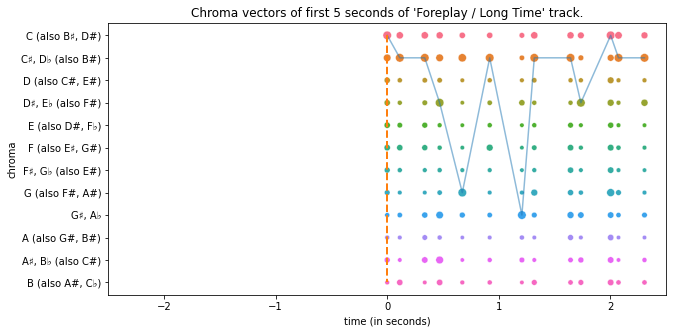

In [4]:
def create_frame(frame, ax): # arguments are `frame number` and `fargs`
    ax.cla()
    window = 5 # show a window of 5 seconds
    step = frame/20 # advance 0.05 seconds per frame
    x1 = -window/2 + step
    x2 = window/2 + step
    scattersamples = (df['start'] >= x1) & (df['start'] <= x2)
    sns.scatterplot(x='start', y='chroma', size='pitch',
        data=df[scattersamples], ax=ax, hue='chroma', legend=False)
    linesamples = (linedf['start'] >= x1) & (linedf['start'] <= x2)
    sns.lineplot(x='start', y='chroma', alpha=0.5,
        data=linedf[linesamples], ax=ax, sort=False, legend=False)
    ax.set_xlim(x1, x2)
    line1, = ax.plot(
            [x1+window/2, x1+window/2],
            ['C (also B♯, D#)', 'B (also A#, C♭)'],
            '--', linewidth=2, label='Dashes set retroactively')
    plt.xlabel('time (in seconds)')
    plt.title('Chroma vectors of first 5 seconds of \'Foreplay / Long Time\' track.')
fig, ax = plt.subplots(figsize=(10, 5))
create_frame(0, ax)

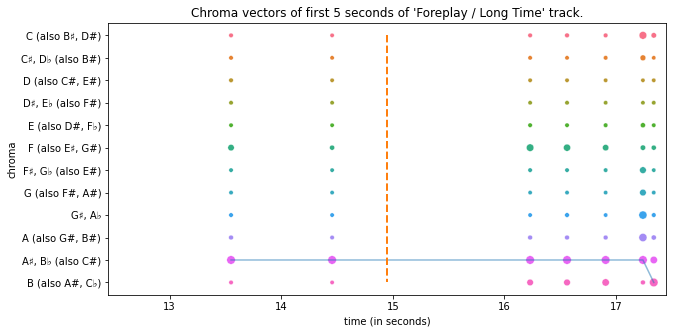

In [5]:
fig, ax = plt.subplots(figsize=(10, 5))
animation = FuncAnimation(fig, create_frame, frames=300, fargs=(ax,),
    interval=50) # Interval at 1000/50 = 20 frames per second
HTML(animation.to_jshtml())

In [9]:
Audio("../example/39C5FuZ8C8M0QI8CrMsPkR.mp3")

MovieWriter imagemagick unavailable; using Pillow instead.


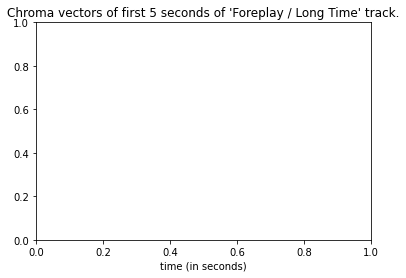

In [15]:
animation.save('../example/39C5FuZ8C8M0QI8CrMsPkR.gif', writer='imagemagick', fps=20)

## Statistical analysis

Import packages

In [1]:
from tracklist import TrackList
from data import load_analysis, load_features
from scipy import stats
import numpy as np
from scipy.stats import entropy
import matplotlib.pylab as pylab

In [2]:
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
pylab.rcParams.update(params)

Define variable

In [3]:
pitch_classes = {
    0: 'C (also B♯, D#)',
    1: 'C♯, D♭ (also B#)',
    2: 'D (also C#, E#)',
    3: 'D♯, E♭ (also F#)',
    4: 'E (also D#, F♭)',
    5: 'F (also E♯, G#)',
    6: 'F♯, G♭ (also E#)',
    7: 'G (also F#, A#)',
    8: 'G♯, A♭',
    9: 'A (also G#, B#)',
    10: 'A♯, B♭ (also C#)',
    11: 'B (also A#, C♭)'
}
data_dir = '../dataset'
song = 0
trim_length = 20

Load data

In [4]:
meta = TrackList.load_from_dir(data_dir)
all_tracks = meta.get_track_ids()

## Investigate overall dataset

In [16]:
analyses = [load_analysis(data_dir, track) for track in all_tracks]
# analyses_trimmed = [load_analysis(data_dir, track) for track in all_tracks]

df = pd.DataFrame([analyses[i]["key"] for i in range(len(all_tracks))], columns=["pitch"])
df['key_confidences'] = [analyses[i]["key_confidence"] for i in range(len(all_tracks))]
df['modes'] = [analyses[i]["mode"] for i in range(len(all_tracks))]
df['mode_confidences'] = [analyses[i]["mode_confidence"] for i in range(len(all_tracks))]
df['durations'] = [analyses[i]["duration"] for i in range(len(all_tracks))]
df['no_segments'] = [len(analyses[i]["pitches"]) for i in range(len(all_tracks))]
df['segment_lens'] = [[np.mean([seg['duration'] for seg in analyses[i]["pitches"]])][0] for i in range(len(all_tracks))]
df['entropies'] = [np.mean(entropy([seg['pitches'] for seg in track['pitches']], base=12)) for track in analyses]
for track in range(len(all_tracks)):
    analyses[track]['pitches'] = [seg for seg in analyses[track]["pitches"] if seg["start"] < trim_length]

df['no_segments_trimmed'] = [len(analyses[i]["pitches"]) for i in range(len(all_tracks))]
df['segment_lens_trimmed'] = [[np.mean([seg['duration'] for seg in analyses[i]["pitches"]])][0] for i in range(len(all_tracks))]
df['entropies_trimmed'] = [np.mean(entropy([seg['pitches'] for seg in track['pitches']], base=12)) for track in analyses]
df.describe()

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

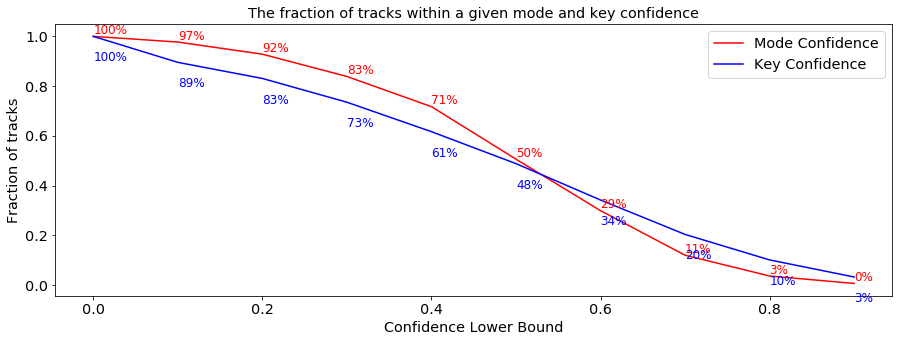

In [283]:
mode_intervals = [len(df[df.mode_confidences >= i])/len(df) for i in np.arange(0, 1, 0.1)]
plt.plot(np.arange(0, 1, 0.1), mode_intervals, label="Mode Confidence", color="red")
key_intervals = [len(df[df.key_confidences >= i])/len(df) for i in np.arange(0, 1, 0.1)]
plt.plot(np.arange(0, 1, 0.1), key_intervals, label="Key Confidence", color="blue")
plt.xlabel('Confidence Lower Bound')
plt.ylabel('Fraction of tracks')
plt.title(f'The fraction of tracks within a given mode and key confidence')
for i, v in zip(np.arange(0, 1, 0.1), mode_intervals):
    plt.text(i, v+0.01, str(int(v*100))+"%", fontsize=12, color="red")
for i, v in zip(np.arange(0, 1, 0.1), key_intervals):
    plt.text(i, v-0.1, str(int(v*100))+"%", fontsize=12, color="blue")
plt.legend()
plt.show()


Double check that we have selected an equal amount of each key and mode

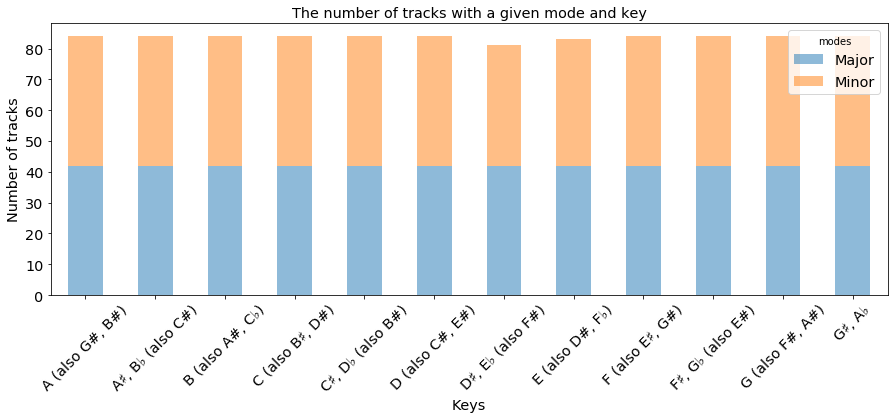

In [347]:
df_comb = df.replace({"pitch": pitch_classes}).replace({"modes": {0: "Minor", 1: "Major"}})[["pitch", "modes"]]
df_comb.groupby(['pitch', 'modes']).size().unstack().plot(kind='bar', stacked=True, alpha=0.5)
plt.xticks(rotation=45)
plt.xlabel('Keys')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks with a given mode and key')
plt.show()

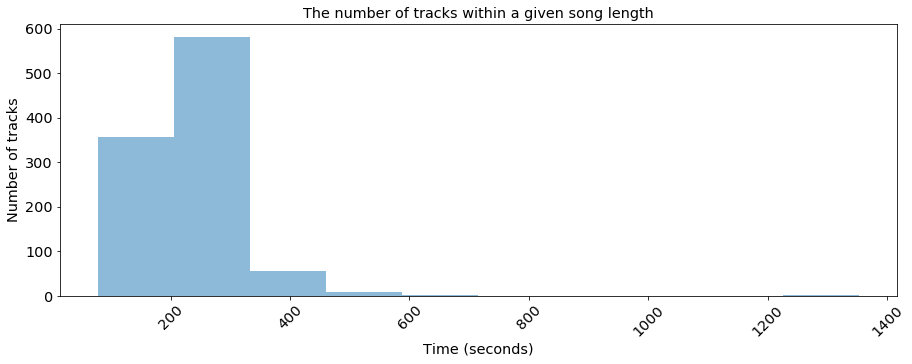

In [16]:
plt.hist(df.durations, alpha=0.5)
plt.xticks(rotation=45)
plt.xlabel('Time (seconds)')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given song length')
plt.show()

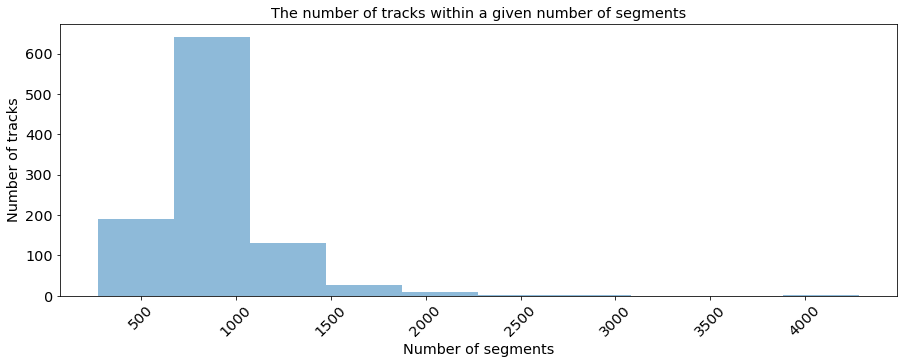

In [312]:
plt.hist(df.no_segments, alpha=0.5)
plt.xticks(rotation=45)
plt.xlabel('Number of segments')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given number of segments')
plt.show()

Compare Trimmed songs to not trimmed

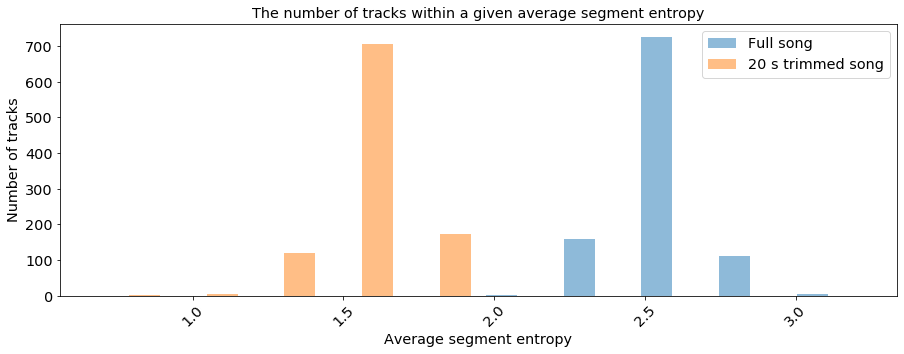

In [309]:
plt.hist([df.entropies, df.entropies_trimmed], alpha=0.5, label=["Full song", "%s s trimmed song"%trim_length])
plt.xticks(rotation=45)
plt.xlabel('Average segment entropy')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given average segment entropy')
plt.legend()
plt.show()

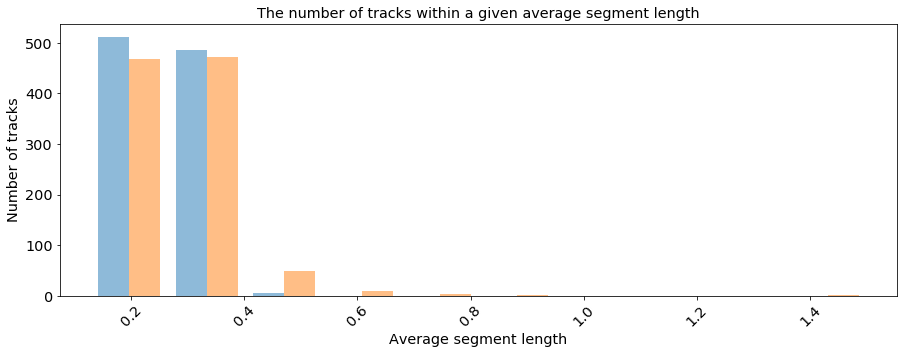

In [311]:
plt.hist([df.segment_lens, df.segment_lens_trimmed], alpha=0.5, label=["Full song", "%s s trimmed song"%trim_length])
plt.xticks(rotation=45)
plt.xlabel('Average segment length')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given average segment length')
plt.show()

In [352]:
x = 3+1j*4
abs(x)**2

25.0

## About
Built by Jeroen Overschie, Jordan Barkai, Thijs Havinga and Pieter Dekker - as part of the Machine Learning course `WMAI010-05` taught on the University of Groningen.